In [8]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from pandas import DataFrame
from scipy import stats
from scipy.stats import pearsonr
from scipy.stats import mannwhitneyu

# Raw Table: Gene expression by Cell

In [9]:
# Importing of the raw data in chunks
df_chunked = pd.DataFrame()
for chunk in pd.read_csv(r'C:\Users\pc\Documents\Databases\Paper 09-6\raw_counts.csv.zip', compression='zip', header= 0, sep=',', quotechar='"', index_col= 0, chunksize = 1000, low_memory=False):
    df_chunked = pd.concat([df_chunked,chunk])

In [10]:
# Transposing the table
df_raw = df_chunked.T

In [11]:
df_raw.head(2)

,ENSG00000000003_TSPAN6,ENSG00000000419_DPM1,ENSG00000000457_SCYL3,ENSG00000000460_C1orf112,ENSG00000001036_FUCA2,ENSG00000001084_GCLC,ENSG00000001167_NFYA,ENSG00000001460_STPG1,ENSG00000001461_NIPAL3,ENSG00000001497_LAS1L,...,ENSG00000269955_LUC7L2,ENSG00000270011_ZNF559-ZNF177,ENSG00000270757_HSPE1-MOB4,ENSG00000270800_RPS10-NUDT3,ENSG00000270872_SRGAP2D,ENSG00000271043_MTRNR2L2,ENSG00000271303_SRXN1,ENSG00000272047_GTF2H5,ENSG00000272325_NUDT3,ENSG00000272398_CD24
21843_1#10,64.776597,59.141261,0.000174,2.558570,9.389441,0.132925,0.000000,16.237659,0.0,68.755162,...,0.707747,0.321706,13.183170,9.742216,0.317078,733.516477,0.0,2.357838,0.926892,7.17182
21843_1#100,44.121248,33.543099,0.140723,11.291487,6.909795,0.017055,9.349543,0.000000,0.0,28.786504,...,0.814032,0.000000,2.665928,0.124172,0.184415,644.882756,0.0,0.832917,1.333080,0.00000


**Each column is a different gene and each row is a different cell with an average of 286 sample cells per person**

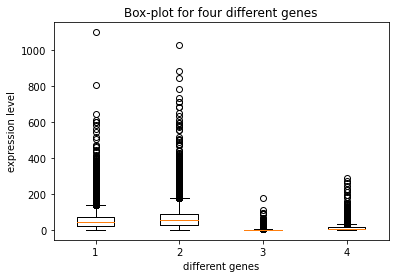

In [12]:
# Looking for observational outliers
columns = [df_raw.ENSG00000000003_TSPAN6, df_raw.ENSG00000000419_DPM1, df_raw.ENSG00000000457_SCYL3, df_raw.ENSG00000000460_C1orf112]

fig, ax = plt.subplots()
ax.boxplot(columns)
plt.title("Box-plot for four different genes")
ax.set_ylabel('expression level')
ax.set_xlabel('different genes')
plt.show()

I wasn't sure about the magnitude of the outliers. So I used the previous code for creating box-plots and checked that. I could find a way to remove the outliers

In [13]:
# Max gene expression values 
max_v= df_raw.max()
max_v

ENSG00000000003_TSPAN6      1099.383334
ENSG00000000419_DPM1        1027.089208
ENSG00000000457_SCYL3        180.242342
ENSG00000000460_C1orf112     288.825222
ENSG00000001036_FUCA2        484.114135
                               ...     
ENSG00000271043_MTRNR2L2    3613.509544
ENSG00000271303_SRXN1        336.619514
ENSG00000272047_GTF2H5        57.102736
ENSG00000272325_NUDT3        201.357684
ENSG00000272398_CD24        2226.475314
Length: 11231, dtype: float64

In [14]:
# The 10 highest expression values
max_v_sorted = sorted(max_v)
max_v_sorted[-10:]

[68080.8357501061,
 68539.2692991809,
 71778.7109382031,
 75640.4999908663,
 79140.3053145554,
 79490.5358478501,
 100230.028927064,
 109764.592553551,
 138303.226608735,
 327212.506739364]

In [15]:
#Taking samples for testing
extra_small_sample = df_raw[:10]
small_sample = df_raw[:50]
medium_sample = df_raw[:100]
large_sample = df_raw[:200]

## Mean, Median, Mode, Variance, Standard Deviation 

### For every column

#### Mean of expression

In [16]:
# Calculating the mean of expression
df_mean = df_raw.mean(axis=0)
df_mean

ENSG00000000003_TSPAN6      53.154975
ENSG00000000419_DPM1        64.588266
ENSG00000000457_SCYL3        1.643968
ENSG00000000460_C1orf112    11.523759
ENSG00000001036_FUCA2       17.370784
                              ...    
ENSG00000271043_MTRNR2L2    99.893841
ENSG00000271303_SRXN1        1.582889
ENSG00000272047_GTF2H5       3.073167
ENSG00000272325_NUDT3        4.171016
ENSG00000272398_CD24        72.286454
Length: 11231, dtype: float64

#### Median of expression

In [17]:
# Calculating the median of expression
df_median = df_raw.median(axis=0)
df_median

ENSG00000000003_TSPAN6      43.452084
ENSG00000000419_DPM1        55.213169
ENSG00000000457_SCYL3        0.133751
ENSG00000000460_C1orf112     7.365946
ENSG00000001036_FUCA2       12.594784
                              ...    
ENSG00000271043_MTRNR2L2    60.231188
ENSG00000271303_SRXN1        0.000000
ENSG00000272047_GTF2H5       2.391586
ENSG00000272325_NUDT3        2.847675
ENSG00000272398_CD24         1.665028
Length: 11231, dtype: float64

#### Mode of expression

In [18]:
# Calculating the mode of expression
#df_mode = df_raw.mode(axis= 0)
#df_mode

#### Variance of expression

In [19]:
# Calculating the variance of expression
df_var = df_raw.var(axis=0)
df_var

ENSG00000000003_TSPAN6       1901.546594
ENSG00000000419_DPM1         2604.003814
ENSG00000000457_SCYL3          16.784827
ENSG00000000460_C1orf112      186.365025
ENSG00000001036_FUCA2         356.939519
                                ...     
ENSG00000271043_MTRNR2L2    29021.773118
ENSG00000271303_SRXN1          35.165156
ENSG00000272047_GTF2H5          7.468196
ENSG00000272325_NUDT3          32.916800
ENSG00000272398_CD24        40082.471696
Length: 11231, dtype: float64

#### Standard Deviation of expression

In [20]:
# Calculating the standard deviation of expression
df_std = df_raw.std(axis=0)
df_std

ENSG00000000003_TSPAN6       43.606726
ENSG00000000419_DPM1         51.029441
ENSG00000000457_SCYL3         4.096929
ENSG00000000460_C1orf112     13.651558
ENSG00000001036_FUCA2        18.892843
                               ...    
ENSG00000271043_MTRNR2L2    170.357780
ENSG00000271303_SRXN1         5.930022
ENSG00000272047_GTF2H5        2.732800
ENSG00000272325_NUDT3         5.737316
ENSG00000272398_CD24        200.206073
Length: 11231, dtype: float64

# Metadata: Cell by Day, donor..... 

In [21]:
# Importing Metadata Table
df_cellmeta= pd.read_csv(r'C:\Users\pc\Documents\Databases\Paper 09-6\cell_metadata_cols.tsv', header= 0, sep='\t', quotechar='"', index_col= 0)

In [22]:
df_cellmeta.head(2)

,assigned,auxDir,cell_filter,cell_name,compatible_fragment_ratio,day,donor,expected_format,experiment,frag_dist_length,...,donor_short_id,donor_long_id,pseudo,PC1_top100hvgs,PC1_top200hvgs,PC1_top500hvgs,PC1_top1000hvgs,PC1_top2000hvgs,princ_curve,princ_curve_scaled01
21843_1#10,1,aux_info,True,21843_1#10,0.999497,day1,joxm,IU,expt_09,1001,...,joxm_1,HPSI0114i-joxm_1,0.292682,-13.353833,-12.969161,-11.769526,-12.153335,-12.871002,39.972588,0.352570
21843_1#100,1,aux_info,True,21843_1#100,0.999456,day1,fafq,IU,expt_09,1001,...,fafq_1,HPSI0314i-fafq_1,0.484716,2.399795,4.633188,5.131531,7.883242,9.916888,56.433387,0.497759


**Each column is a different parameter and each row is a different cell with an average of 286 sample cells per person**

In [23]:
# Loading the full view of the results
pd.set_option("display.max_rows", None, "display.max_columns", None)

# Merging tables: Gene expression by Donor

In [24]:
#Visualizing the max and min contributions of the donors 
df_cellmeta.donor.value_counts(ascending=False)

joxm    1415
guss    1093
poih    1077
nudd     919
sojd     880
letw     801
sehl     800
juuy     640
bokz     637
oibg     629
puie     621
nocf     615
hecn     613
yelp     607
datg     583
qaqx     577
wigw     566
pelm     559
eipl     543
giju     537
qehq     508
zapk     493
guyj     471
eesb     470
qorq     462
wahn     456
fawm     453
meue     451
hayt     443
pipw     439
paab     397
rutc     396
liqa     379
aowh     376
zagm     375
kuco     366
jejf     362
tert     355
vass     350
seru     335
naah     334
xojn     333
zerv     318
melw     317
feec     306
wuye     301
pahc     301
kuxp     299
nufh     298
hoik     296
qunz     293
aoxv     293
fafq     292
pulk     266
hajc     260
kajh     249
tout     247
iisa     245
kolf     243
lise     239
tolg     232
vuna     224
yoch     219
uilk     212
iiyk     209
mita     204
dixh     203
nosn     197
vils     192
iudw     187
oaqd     170
cicb     164
iezw     164
naju     163
fejf     155
cuhk     154
toco     145

The same donor is repeated throughout the days

<AxesSubplot:ylabel='Count'>

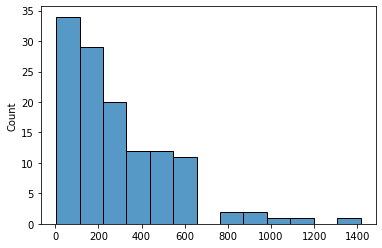

In [25]:
# histogram plotting the distribution of the different number of cells per donor 
sns.histplot(df_cellmeta.donor.value_counts(ascending=False).values)

In [26]:
#creating dataframe with only the information about the donors and the day
genes_days = df_cellmeta[['donor', 'day']].copy()
genes_days.reset_index(drop= True, inplace= True)

## TESTING WITH GUSS

### DAY 0 

Making a correlation of every Cell vs Gene by donor separated in Day 0, Day 1, Day 2 and Day 3 will take a lot of time. So, I'm going to calculate the average expression of the genes and I will use the 100 genes with the highest gene expression.

In [27]:
# Gene expression by cell filtered by day 0 and by donor guss
guss_day0 = df_cellmeta.loc[(df_cellmeta['donor'] == 'guss') & (df_cellmeta['day'] == 'day0'), ['donor','day']].index
gussd0_mrg = df_raw.loc[df_raw.index.isin(guss_day0), :]
gussd0_mrg.head()

,ENSG00000000003_TSPAN6,ENSG00000000419_DPM1,ENSG00000000457_SCYL3,ENSG00000000460_C1orf112,ENSG00000001036_FUCA2,ENSG00000001084_GCLC,ENSG00000001167_NFYA,ENSG00000001460_STPG1,ENSG00000001461_NIPAL3,ENSG00000001497_LAS1L,ENSG00000001617_SEMA3F,ENSG00000001626_CFTR,ENSG00000001629_ANKIB1,ENSG00000001630_CYP51A1,ENSG00000001631_KRIT1,ENSG00000002016_RAD52,ENSG00000002330_BAD,ENSG00000002549_LAP3,ENSG00000002586_CD99,ENSG00000002822_MAD1L1,ENSG00000002834_LASP1,ENSG00000002919_SNX11,ENSG00000003056_M6PR,ENSG00000003096_KLHL13,ENSG00000003147_ICA1,ENSG00000003249_DBNDD1,ENSG00000003393_ALS2,ENSG00000003400_CASP10,ENSG00000003402_CFLAR,ENSG00000003436_TFPI,ENSG00000003509_NDUFAF7,ENSG00000003756_RBM5,ENSG00000003987_MTMR7,ENSG00000004059_ARF5,ENSG00000004142_POLDIP2,ENSG00000004399_PLXND1,ENSG00000004455_AK2,ENSG00000004478_FKBP4,ENSG00000004487_KDM1A,ENSG00000004534_RBM6,ENSG00000004700_RECQL,ENSG00000004766_CCDC132,ENSG00000004779_NDUFAB1,ENSG00000004864_SLC25A13,ENSG00000004866_ST7,ENSG00000004897_CDC27,ENSG00000004948_CALCR,ENSG00000004961_HCCS,ENSG00000004975_DVL2,ENSG00000005007_UPF1,ENSG00000005020_SKAP2,ENSG00000005022_SLC25A5,ENSG00000005059_CCDC109B,ENSG00000005075_POLR2J,ENSG00000005100_DHX33,ENSG00000005156_LIG3,ENSG00000005175_RPAP3,ENSG00000005187_ACSM3,ENSG00000005194_CIAPIN1,ENSG00000005238_FAM214B,ENSG00000005249_PRKAR2B,ENSG00000005302_MSL3,ENSG00000005339_CREBBP,ENSG00000005436_GCFC2,ENSG00000005448_WDR54,ENSG00000005469_CROT,ENSG00000005483_KMT2E,ENSG00000005486_RHBDD2,ENSG00000005700_IBTK,ENSG00000005801_ZNF195,ENSG00000005810_MYCBP2,ENSG00000005812_FBXL3,ENSG00000005882_PDK2,ENSG00000005889_ZFX,ENSG00000005893_LAMP2,ENSG00000005955_GGNBP2,ENSG00000005961_ITGA2B,ENSG00000006007_GDE1,ENSG00000006015_C19orf60,ENSG00000006016_CRLF1,ENSG00000006042_TMEM98,ENSG00000006114_SYNRG,ENSG00000006118_TMEM132A,ENSG00000006125_AP2B1,ENSG00000006194_ZNF263,ENSG00000006282_SPATA20,ENSG00000006327_TNFRSF12A,ENSG00000006432_MAP3K9,ENSG00000006451_RALA,ENSG00000006453_BAIAP2L1,ENSG00000006459_KDM7A,ENSG00000006468_ETV1,ENSG00000006530_AGK,ENSG00000006576_PHTF2,ENSG00000006606_CCL26,ENSG00000006607_FARP2,ENSG00000006625_GGCT,ENSG00000006634_DBF4,ENSG00000006652_IFRD1,ENSG00000006695_COX10,ENSG00000006704_GTF2IRD1,ENSG00000006712_PAF1,ENSG00000006715_VPS41,ENSG00000006744_ELAC2,ENSG00000006747_SCIN,ENSG00000006756_ARSD,ENSG00000006757_PNPLA4,ENSG00000006831_ADIPOR2,ENSG00000006837_CDKL3,ENSG00000007047_MARK4,ENSG00000007062_PROM1,ENSG00000007080_CCDC124,ENSG00000007168_PAFAH1B1,ENSG00000007202_KIAA0100,ENSG00000007255_TRAPPC6A,ENSG00000007264_MATK,ENSG00000007341_ST7L,ENSG00000007376_RPUSD1,ENSG00000007384_RHBDF1,ENSG00000007392_LUC7L,ENSG00000007520_TSR3,ENSG00000007541_PIGQ,ENSG00000007866_TEAD3,ENSG00000007923_DNAJC11,ENSG00000007944_MYLIP,ENSG00000008018_PSMB1,ENSG00000008083_JARID2,ENSG00000008086_CDKL5,ENSG00000008128_CDK11A,ENSG00000008130_NADK,ENSG00000008282_SYPL1,ENSG00000008283_CYB561,ENSG00000008294_SPAG9,ENSG00000008311_AASS,ENSG00000008323_PLEKHG6,ENSG00000008324_SS18L2,ENSG00000008382_MPND,ENSG00000008394_MGST1,ENSG00000008405_CRY1,ENSG00000008513_ST3GAL1,ENSG00000008516_MMP25,ENSG00000008710_PKD1,ENSG00000008838_MED24,ENSG00000008853_RHOBTB2,ENSG00000008869_HEATR5B,ENSG00000008952_SEC62,ENSG00000008988_RPS20,ENSG00000009307_CSDE1,ENSG00000009335_UBE3C,ENSG00000009413_REV3L,ENSG00000009780_FAM76A,ENSG00000009830_POMT2,ENSG00000009844_VTA1,ENSG00000009954_BAZ1B,ENSG00000010017_RANBP9,ENSG00000010072_SPRTN,ENSG00000010165_METTL13,ENSG00000010219_DYRK4,ENSG00000010244_ZNF207,ENSG00000010256_UQCRC1,ENSG00000010270_STARD3NL,ENSG00000010278_CD9,ENSG00000010292_NCAPD2,ENSG00000010295_IFFO1,ENSG00000010318_PHF7,ENSG00000010322_NISCH,ENSG00000010361_FUZ,ENSG00000010404_IDS,ENSG00000010539_ZNF200,ENSG00000010803_SCMH1,ENSG00000010810_FYN,ENSG00000011007_TCEB3,ENSG00000011009_LYPLA2,ENSG00000011021_CLCN6,ENSG00000011028_MRC2,ENSG00000011052_NME2,ENSG00000011105_TSPAN9,ENSG00000011114_BTBD7,ENSG00000011132_APBA3,ENSG0000001114

In [28]:
# median of expression per gen (donor guss)
guss_median0 = gussd0_mrg.median(axis=0)

In [29]:
# sorting the median of expression in descending order (donor guss)
sort_val = guss_median0.sort_values(axis=0, ascending=False, inplace=False, kind= 'quicksort', na_position= 'last')
# we want only the top 100 (highest expression)
b100_guss_d0 = sort_val[:100]

In [30]:
# we want the index of the genes with the highest expression
guss_d0_inx = b100_guss_d0.index

### DAY 1

In [31]:
# Gene expression by cell filtered by day 1 and by donor guss
guss_day1 = df_cellmeta.loc[(df_cellmeta['donor'] == 'guss') & (df_cellmeta['day'] == 'day1'), ['donor','day']].index
gussd1_mrg = df_raw.loc[df_raw.index.isin(guss_day1), :]
gussd1_mrg.head()

,ENSG00000000003_TSPAN6,ENSG00000000419_DPM1,ENSG00000000457_SCYL3,ENSG00000000460_C1orf112,ENSG00000001036_FUCA2,ENSG00000001084_GCLC,ENSG00000001167_NFYA,ENSG00000001460_STPG1,ENSG00000001461_NIPAL3,ENSG00000001497_LAS1L,ENSG00000001617_SEMA3F,ENSG00000001626_CFTR,ENSG00000001629_ANKIB1,ENSG00000001630_CYP51A1,ENSG00000001631_KRIT1,ENSG00000002016_RAD52,ENSG00000002330_BAD,ENSG00000002549_LAP3,ENSG00000002586_CD99,ENSG00000002822_MAD1L1,ENSG00000002834_LASP1,ENSG00000002919_SNX11,ENSG00000003056_M6PR,ENSG00000003096_KLHL13,ENSG00000003147_ICA1,ENSG00000003249_DBNDD1,ENSG00000003393_ALS2,ENSG00000003400_CASP10,ENSG00000003402_CFLAR,ENSG00000003436_TFPI,ENSG00000003509_NDUFAF7,ENSG00000003756_RBM5,ENSG00000003987_MTMR7,ENSG00000004059_ARF5,ENSG00000004142_POLDIP2,ENSG00000004399_PLXND1,ENSG00000004455_AK2,ENSG00000004478_FKBP4,ENSG00000004487_KDM1A,ENSG00000004534_RBM6,ENSG00000004700_RECQL,ENSG00000004766_CCDC132,ENSG00000004779_NDUFAB1,ENSG00000004864_SLC25A13,ENSG00000004866_ST7,ENSG00000004897_CDC27,ENSG00000004948_CALCR,ENSG00000004961_HCCS,ENSG00000004975_DVL2,ENSG00000005007_UPF1,ENSG00000005020_SKAP2,ENSG00000005022_SLC25A5,ENSG00000005059_CCDC109B,ENSG00000005075_POLR2J,ENSG00000005100_DHX33,ENSG00000005156_LIG3,ENSG00000005175_RPAP3,ENSG00000005187_ACSM3,ENSG00000005194_CIAPIN1,ENSG00000005238_FAM214B,ENSG00000005249_PRKAR2B,ENSG00000005302_MSL3,ENSG00000005339_CREBBP,ENSG00000005436_GCFC2,ENSG00000005448_WDR54,ENSG00000005469_CROT,ENSG00000005483_KMT2E,ENSG00000005486_RHBDD2,ENSG00000005700_IBTK,ENSG00000005801_ZNF195,ENSG00000005810_MYCBP2,ENSG00000005812_FBXL3,ENSG00000005882_PDK2,ENSG00000005889_ZFX,ENSG00000005893_LAMP2,ENSG00000005955_GGNBP2,ENSG00000005961_ITGA2B,ENSG00000006007_GDE1,ENSG00000006015_C19orf60,ENSG00000006016_CRLF1,ENSG00000006042_TMEM98,ENSG00000006114_SYNRG,ENSG00000006118_TMEM132A,ENSG00000006125_AP2B1,ENSG00000006194_ZNF263,ENSG00000006282_SPATA20,ENSG00000006327_TNFRSF12A,ENSG00000006432_MAP3K9,ENSG00000006451_RALA,ENSG00000006453_BAIAP2L1,ENSG00000006459_KDM7A,ENSG00000006468_ETV1,ENSG00000006530_AGK,ENSG00000006576_PHTF2,ENSG00000006606_CCL26,ENSG00000006607_FARP2,ENSG00000006625_GGCT,ENSG00000006634_DBF4,ENSG00000006652_IFRD1,ENSG00000006695_COX10,ENSG00000006704_GTF2IRD1,ENSG00000006712_PAF1,ENSG00000006715_VPS41,ENSG00000006744_ELAC2,ENSG00000006747_SCIN,ENSG00000006756_ARSD,ENSG00000006757_PNPLA4,ENSG00000006831_ADIPOR2,ENSG00000006837_CDKL3,ENSG00000007047_MARK4,ENSG00000007062_PROM1,ENSG00000007080_CCDC124,ENSG00000007168_PAFAH1B1,ENSG00000007202_KIAA0100,ENSG00000007255_TRAPPC6A,ENSG00000007264_MATK,ENSG00000007341_ST7L,ENSG00000007376_RPUSD1,ENSG00000007384_RHBDF1,ENSG00000007392_LUC7L,ENSG00000007520_TSR3,ENSG00000007541_PIGQ,ENSG00000007866_TEAD3,ENSG00000007923_DNAJC11,ENSG00000007944_MYLIP,ENSG00000008018_PSMB1,ENSG00000008083_JARID2,ENSG00000008086_CDKL5,ENSG00000008128_CDK11A,ENSG00000008130_NADK,ENSG00000008282_SYPL1,ENSG00000008283_CYB561,ENSG00000008294_SPAG9,ENSG00000008311_AASS,ENSG00000008323_PLEKHG6,ENSG00000008324_SS18L2,ENSG00000008382_MPND,ENSG00000008394_MGST1,ENSG00000008405_CRY1,ENSG00000008513_ST3GAL1,ENSG00000008516_MMP25,ENSG00000008710_PKD1,ENSG00000008838_MED24,ENSG00000008853_RHOBTB2,ENSG00000008869_HEATR5B,ENSG00000008952_SEC62,ENSG00000008988_RPS20,ENSG00000009307_CSDE1,ENSG00000009335_UBE3C,ENSG00000009413_REV3L,ENSG00000009780_FAM76A,ENSG00000009830_POMT2,ENSG00000009844_VTA1,ENSG00000009954_BAZ1B,ENSG00000010017_RANBP9,ENSG00000010072_SPRTN,ENSG00000010165_METTL13,ENSG00000010219_DYRK4,ENSG00000010244_ZNF207,ENSG00000010256_UQCRC1,ENSG00000010270_STARD3NL,ENSG00000010278_CD9,ENSG00000010292_NCAPD2,ENSG00000010295_IFFO1,ENSG00000010318_PHF7,ENSG00000010322_NISCH,ENSG00000010361_FUZ,ENSG00000010404_IDS,ENSG00000010539_ZNF200,ENSG00000010803_SCMH1,ENSG00000010810_FYN,ENSG00000011007_TCEB3,ENSG00000011009_LYPLA2,ENSG00000011021_CLCN6,ENSG00000011028_MRC2,ENSG00000011052_NME2,ENSG00000011105_TSPAN9,ENSG00000011114_BTBD7,ENSG00000011132_APBA3,ENSG0000001114

In [32]:
# median of expression per gen (donor guss)
guss_median1 = gussd1_mrg.median(axis=0)

In [ ]:
# The 100 values with highest median
sort_val = guss_median1.sort_values(axis=0, ascending=False, inplace=False, kind= 'quicksort', na_position= 'last')
# we want only the top 100 (highest expression)
b100_guss_d1 = sort_val[:100]
b100_guss_d1.head()

In [34]:
# we want the index of the genes with the highest expression
guss_d1_inx = b100_guss_d1.index

### DAY 2

In [35]:
# Gene expression by cell filtered by day 2 and by donor guss
guss_day2 = df_cellmeta.loc[(df_cellmeta['donor'] == 'guss') & (df_cellmeta['day'] == 'day2'), ['donor','day']].index
gussd2_mrg = df_raw.loc[df_raw.index.isin(guss_day2), :]
gussd2_mrg.head()

,ENSG00000000003_TSPAN6,ENSG00000000419_DPM1,ENSG00000000457_SCYL3,ENSG00000000460_C1orf112,ENSG00000001036_FUCA2,ENSG00000001084_GCLC,ENSG00000001167_NFYA,ENSG00000001460_STPG1,ENSG00000001461_NIPAL3,ENSG00000001497_LAS1L,ENSG00000001617_SEMA3F,ENSG00000001626_CFTR,ENSG00000001629_ANKIB1,ENSG00000001630_CYP51A1,ENSG00000001631_KRIT1,ENSG00000002016_RAD52,ENSG00000002330_BAD,ENSG00000002549_LAP3,ENSG00000002586_CD99,ENSG00000002822_MAD1L1,ENSG00000002834_LASP1,ENSG00000002919_SNX11,ENSG00000003056_M6PR,ENSG00000003096_KLHL13,ENSG00000003147_ICA1,ENSG00000003249_DBNDD1,ENSG00000003393_ALS2,ENSG00000003400_CASP10,ENSG00000003402_CFLAR,ENSG00000003436_TFPI,ENSG00000003509_NDUFAF7,ENSG00000003756_RBM5,ENSG00000003987_MTMR7,ENSG00000004059_ARF5,ENSG00000004142_POLDIP2,ENSG00000004399_PLXND1,ENSG00000004455_AK2,ENSG00000004478_FKBP4,ENSG00000004487_KDM1A,ENSG00000004534_RBM6,ENSG00000004700_RECQL,ENSG00000004766_CCDC132,ENSG00000004779_NDUFAB1,ENSG00000004864_SLC25A13,ENSG00000004866_ST7,ENSG00000004897_CDC27,ENSG00000004948_CALCR,ENSG00000004961_HCCS,ENSG00000004975_DVL2,ENSG00000005007_UPF1,ENSG00000005020_SKAP2,ENSG00000005022_SLC25A5,ENSG00000005059_CCDC109B,ENSG00000005075_POLR2J,ENSG00000005100_DHX33,ENSG00000005156_LIG3,ENSG00000005175_RPAP3,ENSG00000005187_ACSM3,ENSG00000005194_CIAPIN1,ENSG00000005238_FAM214B,ENSG00000005249_PRKAR2B,ENSG00000005302_MSL3,ENSG00000005339_CREBBP,ENSG00000005436_GCFC2,ENSG00000005448_WDR54,ENSG00000005469_CROT,ENSG00000005483_KMT2E,ENSG00000005486_RHBDD2,ENSG00000005700_IBTK,ENSG00000005801_ZNF195,ENSG00000005810_MYCBP2,ENSG00000005812_FBXL3,ENSG00000005882_PDK2,ENSG00000005889_ZFX,ENSG00000005893_LAMP2,ENSG00000005955_GGNBP2,ENSG00000005961_ITGA2B,ENSG00000006007_GDE1,ENSG00000006015_C19orf60,ENSG00000006016_CRLF1,ENSG00000006042_TMEM98,ENSG00000006114_SYNRG,ENSG00000006118_TMEM132A,ENSG00000006125_AP2B1,ENSG00000006194_ZNF263,ENSG00000006282_SPATA20,ENSG00000006327_TNFRSF12A,ENSG00000006432_MAP3K9,ENSG00000006451_RALA,ENSG00000006453_BAIAP2L1,ENSG00000006459_KDM7A,ENSG00000006468_ETV1,ENSG00000006530_AGK,ENSG00000006576_PHTF2,ENSG00000006606_CCL26,ENSG00000006607_FARP2,ENSG00000006625_GGCT,ENSG00000006634_DBF4,ENSG00000006652_IFRD1,ENSG00000006695_COX10,ENSG00000006704_GTF2IRD1,ENSG00000006712_PAF1,ENSG00000006715_VPS41,ENSG00000006744_ELAC2,ENSG00000006747_SCIN,ENSG00000006756_ARSD,ENSG00000006757_PNPLA4,ENSG00000006831_ADIPOR2,ENSG00000006837_CDKL3,ENSG00000007047_MARK4,ENSG00000007062_PROM1,ENSG00000007080_CCDC124,ENSG00000007168_PAFAH1B1,ENSG00000007202_KIAA0100,ENSG00000007255_TRAPPC6A,ENSG00000007264_MATK,ENSG00000007341_ST7L,ENSG00000007376_RPUSD1,ENSG00000007384_RHBDF1,ENSG00000007392_LUC7L,ENSG00000007520_TSR3,ENSG00000007541_PIGQ,ENSG00000007866_TEAD3,ENSG00000007923_DNAJC11,ENSG00000007944_MYLIP,ENSG00000008018_PSMB1,ENSG00000008083_JARID2,ENSG00000008086_CDKL5,ENSG00000008128_CDK11A,ENSG00000008130_NADK,ENSG00000008282_SYPL1,ENSG00000008283_CYB561,ENSG00000008294_SPAG9,ENSG00000008311_AASS,ENSG00000008323_PLEKHG6,ENSG00000008324_SS18L2,ENSG00000008382_MPND,ENSG00000008394_MGST1,ENSG00000008405_CRY1,ENSG00000008513_ST3GAL1,ENSG00000008516_MMP25,ENSG00000008710_PKD1,ENSG00000008838_MED24,ENSG00000008853_RHOBTB2,ENSG00000008869_HEATR5B,ENSG00000008952_SEC62,ENSG00000008988_RPS20,ENSG00000009307_CSDE1,ENSG00000009335_UBE3C,ENSG00000009413_REV3L,ENSG00000009780_FAM76A,ENSG00000009830_POMT2,ENSG00000009844_VTA1,ENSG00000009954_BAZ1B,ENSG00000010017_RANBP9,ENSG00000010072_SPRTN,ENSG00000010165_METTL13,ENSG00000010219_DYRK4,ENSG00000010244_ZNF207,ENSG00000010256_UQCRC1,ENSG00000010270_STARD3NL,ENSG00000010278_CD9,ENSG00000010292_NCAPD2,ENSG00000010295_IFFO1,ENSG00000010318_PHF7,ENSG00000010322_NISCH,ENSG00000010361_FUZ,ENSG00000010404_IDS,ENSG00000010539_ZNF200,ENSG00000010803_SCMH1,ENSG00000010810_FYN,ENSG00000011007_TCEB3,ENSG00000011009_LYPLA2,ENSG00000011021_CLCN6,ENSG00000011028_MRC2,ENSG00000011052_NME2,ENSG00000011105_TSPAN9,ENSG00000011114_BTBD7,ENSG00000011132_APBA3,ENSG0000001114

In [36]:
# median of expression per gen (donor guss)
guss_median2 = gussd2_mrg.median(axis=0)

In [37]:
# The 100 values with highest median
sort_val = guss_median2.sort_values(axis=0, ascending=False, inplace=False, kind= 'quicksort', na_position= 'last')
# we want only the top 100 (highest expression)
b100_guss_d2 = sort_val[:100]

In [38]:
# we want the index of the genes with the highest expression
guss_d2_inx = b100_guss_d2.index

### DAY 3

In [39]:
# Gene expression by cell filtered by day 3 and by donor guss
guss_day3 = df_cellmeta.loc[(df_cellmeta['donor'] == 'guss') & (df_cellmeta['day'] == 'day3'), ['donor','day']].index
gussd3_mrg = df_raw.loc[df_raw.index.isin(guss_day3), :]
gussd3_mrg.head()

,ENSG00000000003_TSPAN6,ENSG00000000419_DPM1,ENSG00000000457_SCYL3,ENSG00000000460_C1orf112,ENSG00000001036_FUCA2,ENSG00000001084_GCLC,ENSG00000001167_NFYA,ENSG00000001460_STPG1,ENSG00000001461_NIPAL3,ENSG00000001497_LAS1L,ENSG00000001617_SEMA3F,ENSG00000001626_CFTR,ENSG00000001629_ANKIB1,ENSG00000001630_CYP51A1,ENSG00000001631_KRIT1,ENSG00000002016_RAD52,ENSG00000002330_BAD,ENSG00000002549_LAP3,ENSG00000002586_CD99,ENSG00000002822_MAD1L1,ENSG00000002834_LASP1,ENSG00000002919_SNX11,ENSG00000003056_M6PR,ENSG00000003096_KLHL13,ENSG00000003147_ICA1,ENSG00000003249_DBNDD1,ENSG00000003393_ALS2,ENSG00000003400_CASP10,ENSG00000003402_CFLAR,ENSG00000003436_TFPI,ENSG00000003509_NDUFAF7,ENSG00000003756_RBM5,ENSG00000003987_MTMR7,ENSG00000004059_ARF5,ENSG00000004142_POLDIP2,ENSG00000004399_PLXND1,ENSG00000004455_AK2,ENSG00000004478_FKBP4,ENSG00000004487_KDM1A,ENSG00000004534_RBM6,ENSG00000004700_RECQL,ENSG00000004766_CCDC132,ENSG00000004779_NDUFAB1,ENSG00000004864_SLC25A13,ENSG00000004866_ST7,ENSG00000004897_CDC27,ENSG00000004948_CALCR,ENSG00000004961_HCCS,ENSG00000004975_DVL2,ENSG00000005007_UPF1,ENSG00000005020_SKAP2,ENSG00000005022_SLC25A5,ENSG00000005059_CCDC109B,ENSG00000005075_POLR2J,ENSG00000005100_DHX33,ENSG00000005156_LIG3,ENSG00000005175_RPAP3,ENSG00000005187_ACSM3,ENSG00000005194_CIAPIN1,ENSG00000005238_FAM214B,ENSG00000005249_PRKAR2B,ENSG00000005302_MSL3,ENSG00000005339_CREBBP,ENSG00000005436_GCFC2,ENSG00000005448_WDR54,ENSG00000005469_CROT,ENSG00000005483_KMT2E,ENSG00000005486_RHBDD2,ENSG00000005700_IBTK,ENSG00000005801_ZNF195,ENSG00000005810_MYCBP2,ENSG00000005812_FBXL3,ENSG00000005882_PDK2,ENSG00000005889_ZFX,ENSG00000005893_LAMP2,ENSG00000005955_GGNBP2,ENSG00000005961_ITGA2B,ENSG00000006007_GDE1,ENSG00000006015_C19orf60,ENSG00000006016_CRLF1,ENSG00000006042_TMEM98,ENSG00000006114_SYNRG,ENSG00000006118_TMEM132A,ENSG00000006125_AP2B1,ENSG00000006194_ZNF263,ENSG00000006282_SPATA20,ENSG00000006327_TNFRSF12A,ENSG00000006432_MAP3K9,ENSG00000006451_RALA,ENSG00000006453_BAIAP2L1,ENSG00000006459_KDM7A,ENSG00000006468_ETV1,ENSG00000006530_AGK,ENSG00000006576_PHTF2,ENSG00000006606_CCL26,ENSG00000006607_FARP2,ENSG00000006625_GGCT,ENSG00000006634_DBF4,ENSG00000006652_IFRD1,ENSG00000006695_COX10,ENSG00000006704_GTF2IRD1,ENSG00000006712_PAF1,ENSG00000006715_VPS41,ENSG00000006744_ELAC2,ENSG00000006747_SCIN,ENSG00000006756_ARSD,ENSG00000006757_PNPLA4,ENSG00000006831_ADIPOR2,ENSG00000006837_CDKL3,ENSG00000007047_MARK4,ENSG00000007062_PROM1,ENSG00000007080_CCDC124,ENSG00000007168_PAFAH1B1,ENSG00000007202_KIAA0100,ENSG00000007255_TRAPPC6A,ENSG00000007264_MATK,ENSG00000007341_ST7L,ENSG00000007376_RPUSD1,ENSG00000007384_RHBDF1,ENSG00000007392_LUC7L,ENSG00000007520_TSR3,ENSG00000007541_PIGQ,ENSG00000007866_TEAD3,ENSG00000007923_DNAJC11,ENSG00000007944_MYLIP,ENSG00000008018_PSMB1,ENSG00000008083_JARID2,ENSG00000008086_CDKL5,ENSG00000008128_CDK11A,ENSG00000008130_NADK,ENSG00000008282_SYPL1,ENSG00000008283_CYB561,ENSG00000008294_SPAG9,ENSG00000008311_AASS,ENSG00000008323_PLEKHG6,ENSG00000008324_SS18L2,ENSG00000008382_MPND,ENSG00000008394_MGST1,ENSG00000008405_CRY1,ENSG00000008513_ST3GAL1,ENSG00000008516_MMP25,ENSG00000008710_PKD1,ENSG00000008838_MED24,ENSG00000008853_RHOBTB2,ENSG00000008869_HEATR5B,ENSG00000008952_SEC62,ENSG00000008988_RPS20,ENSG00000009307_CSDE1,ENSG00000009335_UBE3C,ENSG00000009413_REV3L,ENSG00000009780_FAM76A,ENSG00000009830_POMT2,ENSG00000009844_VTA1,ENSG00000009954_BAZ1B,ENSG00000010017_RANBP9,ENSG00000010072_SPRTN,ENSG00000010165_METTL13,ENSG00000010219_DYRK4,ENSG00000010244_ZNF207,ENSG00000010256_UQCRC1,ENSG00000010270_STARD3NL,ENSG00000010278_CD9,ENSG00000010292_NCAPD2,ENSG00000010295_IFFO1,ENSG00000010318_PHF7,ENSG00000010322_NISCH,ENSG00000010361_FUZ,ENSG00000010404_IDS,ENSG00000010539_ZNF200,ENSG00000010803_SCMH1,ENSG00000010810_FYN,ENSG00000011007_TCEB3,ENSG00000011009_LYPLA2,ENSG00000011021_CLCN6,ENSG00000011028_MRC2,ENSG00000011052_NME2,ENSG00000011105_TSPAN9,ENSG00000011114_BTBD7,ENSG00000011132_APBA3,ENSG0000001114

In [40]:
# median of expression per gen (donor guss)
guss_median3 = gussd3_mrg.median(axis=0)

In [41]:
# The 100 values with highest median
sort_val = guss_median3.sort_values(axis=0, ascending=False, inplace=False, kind= 'quicksort', na_position= 'last')
# we want only the top 100 (highest expression)
b100_guss_d3 = sort_val[:100]

In [42]:
# we want the index of the genes with the highest expression
guss_d3_inx = b100_guss_d3.index

## Gene expression comparison between Days 0-3

In [43]:
# The sum of the lenghts must be 1093
print(len(gussd0_mrg) + len(gussd1_mrg) + len(gussd2_mrg) + len(gussd3_mrg))

1093


### Mann-Whitney for Days 0 and 1
###### Under the alternative hypothesis, the values of one of the samples tends to exceed those of the other

In [44]:
# Applying mannwhitney test on each column of the df's day0 and day1 and saving the values on a list
list_pval1 = []
for column in range(0, len(gussd0_mrg.columns)):
    guss_d0_columns = gussd0_mrg.iloc[:,column]
    guss_d1_columns = gussd1_mrg.iloc[:,column]
    U1, p = mannwhitneyu(guss_d0_columns.values, guss_d1_columns.values)
    list_pval1.append(p)

# Extracting the column names because we want to zip these column names with the p-values obtained
gussd0_colnames = list(gussd0_mrg.columns.values)

In [45]:
# zipping the column names (gene names) with the p-value values
zip_pvalcolnames_d0d1 = list(zip(gussd0_colnames, list_pval1))

In [46]:
# Converting to DataFrame and renaming the columns
mwhitney_pvalor_d0d1 = pd.DataFrame(zip_pvalcolnames_d0d1, columns = ["gene", "p-valor"])
mwhitney_pvalor_d0d1 = mwhitney_pvalor_d0d1.set_index("gene")

In [47]:
# applying log of the p-value
guss_mwhpval_d0d1 = -np.log(mwhitney_pvalor_d0d1["p-valor"])

In [48]:
# filtering the p-values with a value < 0.05
mwh_p_filt_d0d1 = mwhitney_pvalor_d0d1.loc[mwhitney_pvalor_d0d1["p-valor"] < 0.05]
print(str(len(mwhitney_pvalor_d0d1) - len(mwh_p_filt_d0d1)) + " genes were filtered")

4115 genes were filtered


In [49]:
# we want the top 100 values
mwhitf_sort_d0d1 = mwh_p_filt_d0d1.sort_values(by= "p-valor", axis=0, ascending= True, inplace=False, kind= 'quicksort', na_position= 'last')
mwhitf_sort_d0d1 = mwhitf_sort_d0d1[:1000]
mwhitf_sort_d0d1

,p-valor
gene,
ENSG00000164458_T,1.294723e-105
ENSG00000163508_EOMES,3.197108e-105
ENSG00000204335_SP5,4.430194e-104
ENSG00000185155_MIXL1,6.821461e-101
ENSG00000128683_GAD1,2.962354e-100
ENSG00000154096_THY1,5.547860e-78
ENSG00000108379_WNT3,4.807664e-76
ENSG00000179046_TRIML2,3.039866e-74
ENSG00000156574_NODAL,6.309511e-74


In [50]:
# For better visualization, we want the np.log of the p-values. The highest the np.log, the smallest the p-value extracted
guss_log_d0d1 = -np.log(mwhitf_sort_d0d1["p-valor"])

### Mann-Whitney for Days 1 and 2
###### Under the alternative hypothesis, the values of one of the samples tends to exceed those of the other

In [51]:
# Applying mannwhitney test on each column of the df's day1 and day2 and saving the values on a list
list_pval2 = []
for column in range(0, len(gussd1_mrg.columns)):
    guss_d1_columns = gussd1_mrg.iloc[:,column]
    guss_d2_columns = gussd2_mrg.iloc[:,column]
    U1, p = mannwhitneyu(guss_d1_columns.values, guss_d2_columns.values)
    list_pval2.append(p)

# Extracting the column names because we want to zip these column names with the p-values obtained
gussd1_colnames = list(gussd1_mrg.columns.values)

In [52]:
# zipping the column names with the p-value values
zip_pvalcolnames_d1d2 = list(zip(gussd1_colnames, list_pval2))

In [53]:
# Converting to DataFrame and renaming the columns
mwhitney_pvalor_d1d2 = pd.DataFrame(zip_pvalcolnames_d1d2, columns = ["gene", "p-valor"])
mwhitney_pvalor_d1d2 = mwhitney_pvalor_d1d2.set_index("gene")

In [54]:
# applying log of the p-value
guss_mwhpval_d1d2 = -np.log(mwhitney_pvalor_d1d2["p-valor"])

In [55]:
# filtering the p-values with a value < 0.05
mwh_p_filt_d1d2 = mwhitney_pvalor_d1d2.loc[mwhitney_pvalor_d1d2["p-valor"] < 0.05]
print(str(len(mwhitney_pvalor_d1d2) - len(mwh_p_filt_d1d2)) + " genes were filtered")

4109 genes were filtered


In [94]:
# we want the top 100 values
mwhitf_sort_d1d2 = mwh_p_filt_d1d2.sort_values(by= "p-valor", axis=0, ascending= True, inplace=False, kind= 'quicksort', na_position= 'last')
mwhitf_sort_d1d2 = mwhitf_sort_d1d2[:100]
mwhitf_sort_d1d2.head()

,p-valor
gene,
ENSG00000158815_FGF17,2.781381e-64
ENSG00000132130_LHX1,1.788382e-63
ENSG00000141448_GATA6,5.241684e-56
ENSG00000147869_CER1,1.284292e-53
ENSG00000109971_HSPA8,3.185178e-53


In [57]:
# For better visualization, we want the np.log of the p-values. The highest the np.log, the smallest the p-value extracted
guss_log_d1d2 = -np.log(mwhitf_sort_d1d2["p-valor"])

### Mann-Whitney for Days 2 and 3
###### Under the alternative hypothesis, the values of one of the samples tends to exceed those of the other

In [58]:
#Identifying the columns with repeated values
nunique_d2 = gussd2_mrg.nunique()
cols_to_drop_d2 = nunique_d2[nunique_d2 == 1].index
cols_to_drop_d2

nunique_d3 = gussd3_mrg.nunique()
cols_to_drop_d3 = nunique_d3[nunique_d3 == 1].index
cols_to_drop_d3

Index(['ENSG00000015413_DPEP1', 'ENSG00000188816_HMX2'], dtype='object')

In [59]:
#Deleting the columns with repeated values and correcting the table
gussd2_mrg_nice = gussd2_mrg.drop('ENSG00000015413_DPEP1', 1)
gussd3_mrg_nice = gussd3_mrg.drop('ENSG00000015413_DPEP1', 1)

In [60]:
# Applying mannwhitney test on each column of the df's day2 and day3 and saving the values on a list
list_pval3 = []
for column in range(0, len(gussd2_mrg_nice.columns)):
    guss_d2_columns = gussd2_mrg_nice.iloc[:,column]
    guss_d3_columns = gussd3_mrg_nice.iloc[:,column]
    U1, p = mannwhitneyu(guss_d2_columns.values, guss_d3_columns.values)
    list_pval3.append(p)

# Extracting the column names because we want to zip these column names with the p-values obtained
gussd2_colnames = list(gussd2_mrg.columns.values)

In [61]:
# zipping the column names with the p-value values
zip_pvalcolnames_d2d3 = list(zip(gussd2_colnames, list_pval3))

In [62]:
# Converting to DataFrame and renaming the columns
mwhitney_pvalor_d2d3 = pd.DataFrame(zip_pvalcolnames_d2d3, columns = ["gene", "p-valor"])
mwhitney_pvalor_d2d3 = mwhitney_pvalor_d2d3.set_index("gene")

In [63]:
# applying log of the p-value
guss_mwhpval_d2d3 = -np.log(mwhitney_pvalor_d2d3["p-valor"])

In [64]:
# filtering the p-values with a value < 0.05
mwh_p_filt_d2d3 = mwhitney_pvalor_d2d3.loc[mwhitney_pvalor_d2d3["p-valor"] < 0.05]
print(str(len(mwhitney_pvalor_d2d3) - len(mwh_p_filt_d2d3)) + " genes were filtered")

5751 genes were filtered


In [65]:
# we want the top 100 values
mwhitf_sort_d2d3 = mwh_p_filt_d2d3.sort_values(by= "p-valor", axis=0, ascending= True, inplace=False, kind= 'quicksort', na_position= 'last')
mwhitf_sort_d2d3 = mwhitf_sort_d2d3[:100]
mwhitf_sort_d2d3

,p-valor
gene,
ENSG00000110108_TMEM109,1.162948e-61
ENSG00000171763_SPATA5L1,5.030014e-52
ENSG00000197405_C5AR1,2.194517e-47
ENSG00000170417_TMEM182,1.556162e-41
ENSG00000174456_C12orf76,1.063562e-40
ENSG00000169093_ASMTL,3.235300e-40
ENSG00000160917_CPSF4,3.616830e-40
ENSG00000085840_ORC1,1.060672e-39
ENSG00000070731_ST6GALNAC2,3.219245e-39


#### D0 - D1 / D1 - D2 / D2 - D3

Text(0.5, 1.0, 'day2 - day3')

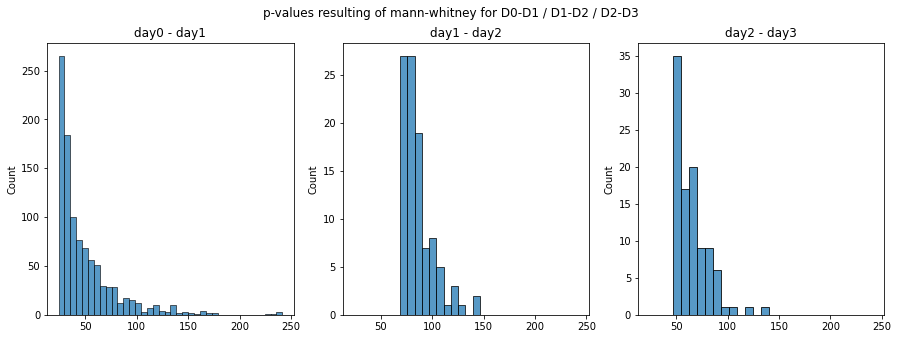

In [67]:
fig, axes = plt.subplots(1, 3, sharex=True, figsize=(15,5))
fig.suptitle('p-values resulting of mann-whitney for D0-D1 / D1-D2 / D2-D3 ')

# Day0 - Day1
sns.histplot(ax= axes[0],x= guss_log_d0d1.values)
axes[0].set_title("day0 - day1")

# Day1 - Day2
sns.histplot(ax= axes[1],x= guss_log_d1d2.values)
axes[1].set_title("day1 - day2")

# Day2 - Day3
sns.histplot(ax= axes[2],x= guss_log_d2d3.values)
axes[2].set_title("day2 - day3")

#### Genes in common between the four Days

In [68]:
# the top 100 genes in common between the days 0-3. This was useful because we were able to see that the common genes were, in fact, house-keeping genes. So, we could infered that the previous steps are good 
guss_common_genes = set(guss_d0_inx) & set(guss_d1_inx) & set(guss_d2_inx) & set(guss_d3_inx)
guss_common_genes

{'ENSG00000034510_TMSB10',
 'ENSG00000063177_RPL18',
 'ENSG00000071082_RPL31',
 'ENSG00000075624_ACTB',
 'ENSG00000083845_RPS5',
 'ENSG00000084207_GSTP1',
 'ENSG00000087086_FTL',
 'ENSG00000089009_RPL6',
 'ENSG00000089157_RPLP0',
 'ENSG00000092841_MYL6',
 'ENSG00000100316_RPL3',
 'ENSG00000105193_RPS16',
 'ENSG00000105640_RPL18A',
 'ENSG00000108298_RPL19',
 'ENSG00000108518_PFN1',
 'ENSG00000109475_RPL34',
 'ENSG00000110700_RPS13',
 'ENSG00000111640_GAPDH',
 'ENSG00000111716_LDHB',
 'ENSG00000112306_RPS12',
 'ENSG00000114391_RPL24',
 'ENSG00000115268_RPS15',
 'ENSG00000122406_RPL5',
 'ENSG00000123416_TUBA1B',
 'ENSG00000124614_RPS10',
 'ENSG00000130255_RPL36',
 'ENSG00000131469_RPL27',
 'ENSG00000135486_HNRNPA1',
 'ENSG00000136942_RPL35',
 'ENSG00000137154_RPS6',
 'ENSG00000137818_RPLP1',
 'ENSG00000138326_RPS24',
 'ENSG00000140988_RPS2',
 'ENSG00000142534_RPS11',
 'ENSG00000142541_RPL13A',
 'ENSG00000142676_RPL11',
 'ENSG00000143947_RPS27A',
 'ENSG00000144713_RPL32',
 'ENSG00000145425

#### Differences between the Days

In [69]:
guss_diff_d0d1 = (set(guss_d0_inx) - set(guss_d1_inx)) #Day 0 but not in Day 1
guss_diff_d1d0 = (set(guss_d1_inx) - set(guss_d0_inx)) #Day 1 but not in Day 0
guss_diff_d1d2 = (set(guss_d1_inx) - set(guss_d2_inx)) #Day 1 but not in Day 2
guss_diff_d2d1 = (set(guss_d2_inx) - set(guss_d1_inx)) #Day 2 but not in Day 1
guss_diff_d2d3 = (set(guss_d2_inx) - set(guss_d3_inx)) #Day 2 but not in Day 3
guss_diff_d3d2 = (set(guss_d3_inx) - set(guss_d2_inx)) #Day 3 but not in Day 2

#### One-gene Tracing

In [70]:
#Examples of genes for testing: ENSG00000087086_FTL - ENSG00000186468_RPS23  -  ENSG00000111640_GAPDH
gene = input("Enter a gene: ")

Enter a gene: ENSG00000087086_FTL


In [112]:
mwhitney_pvalor_d2d3.loc["ENSG00000000003_TSPAN6"]

p-valor    0.101109
Name: ENSG00000000003_TSPAN6, dtype: float64

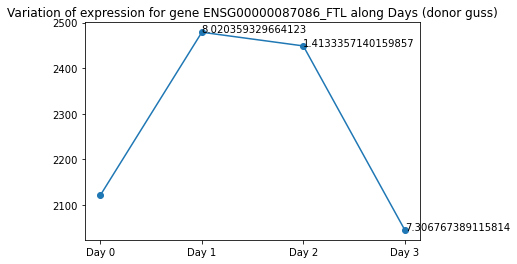

In [106]:
plt.scatter(["Day 0", "Day 1", "Day 2", "Day 3"], [b100_guss_d0[gene], b100_guss_d1[gene], b100_guss_d2[gene], b100_guss_d3[gene]])
plt.plot(["Day 0", "Day 1", "Day 2", "Day 3"], [b100_guss_d0[gene], b100_guss_d1[gene], b100_guss_d2[gene], b100_guss_d3[gene]])
plt.title("Variation of expression for gene " + gene + " along Days (donor guss)")
plt.annotate(guss_mwhpval_d0d1[gene],
             ("Day 1",b100_guss_d1[gene]))
plt.annotate(guss_mwhpval_d1d2[gene],
             ("Day 2",b100_guss_d2[gene]))
plt.annotate(guss_mwhpval_d2d3[gene],
             ("Day 3",b100_guss_d3[gene]))# these are the coordinates to position the label
plt.show()

In [129]:
# from what value can it be considered significant?
print("Statistical significance: from values > " + str(-np.log(0.05)))

Statistical significance: from values > 2.995732273553991


En el gráfico conviene poner el p-valor real (no supe cómo hacerlo)

Se puede hacer subplot con 3 columnas del log de p-value y queda lindo visualmente con los genes, la evolución y re cool

In [72]:
print("The p-value log between d0 and d1: " + str(guss_mwhpval_d0d1[gene]))
print("The p-value log between d1 and d2: " + str(guss_mwhpval_d1d2[gene]))
print("The p-value log between d2 and d3: " + str(guss_mwhpval_d2d3[gene]))

The p-value log between d0 and d1: 8.020359329664123
The p-value log between d1 and d2: 1.4133357140159857
The p-value log between d2 and d3: 7.306767389115814


In [73]:
print(b100_guss_d0[gene])
print(b100_guss_d1[gene])
print(b100_guss_d2[gene])
print(b100_guss_d3[gene])

2121.69689929823
2478.77596275567
2448.802442635685
2045.52279116446


### Guss comparing gene expression of the most variated genes

#### Extracting the median of gene expression of guss

In [74]:
# Making dataframes from GUSS gene expression median by day
guss_median0 = pd.DataFrame(guss_median0)
guss_median0.columns = ['day0']
guss_median1 = pd.DataFrame(guss_median1)
guss_median1.columns = ['day1']
guss_median2 = pd.DataFrame(guss_median2)
guss_median2.columns = ['day2']
guss_median3 = pd.DataFrame(guss_median3)
guss_median3.columns = ['day3']

#### Extracting the genes with the biggest variance

In [75]:
# iterating through each column and calculating the variance in the day 0 (donor guss)
list_gussvar0 = []
for column in range(0, len(gussd0_mrg.columns)):
    d0_columns = gussd0_mrg.iloc[:,column]
    d0_var = np.var(d0_columns.values)
    list_gussvar0.append(d0_var)
d0_colnames = list(gussd0_mrg.columns.values)

# zipping the names of the columns with their respective p-values
zip_varcolnames_d0 = list(zip(d0_colnames, list_gussvar0))

# Converting to DataFrame and renaming the columns
guss_var_d0 = pd.DataFrame(zip_varcolnames_d0, columns = ["gene", "var"])
guss_var_d0 = guss_var_d0.set_index("gene")

# we want the top 1000 values
gus_var_sort_d0 = guss_var_d0.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
gus_var_sort_d0 = gus_var_sort_d0[:1000]

In [76]:
# iterating through each column and calculating the variance in the day 1 (donor guss)
list_gussvar1 = []
for column in range(0, len(gussd1_mrg.columns)):
    d1_columns = gussd1_mrg.iloc[:,column]
    d1_var = np.var(d1_columns.values)
    list_gussvar1.append(d1_var)
d1_colnames = list(gussd1_mrg.columns.values)

# zipping the names of the columns with their respective p-values
zip_varcolnames_d1 = list(zip(d1_colnames, list_gussvar1))

# Converting to DataFrame and renaming the columns
guss_var_d1 = pd.DataFrame(zip_varcolnames_d1, columns = ["gene", "var"])
guss_var_d1 = guss_var_d1.set_index("gene")

# we want the top 1000 values
gus_var_sort_d1 = guss_var_d1.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
gus_var_sort_d1 = gus_var_sort_d1[:1000]

In [77]:
# iterating through each column and calculating the variance in the day 2 (donor guss)
list_gussvar2 = []
for column in range(0, len(gussd2_mrg.columns)):
    d2_columns = gussd2_mrg.iloc[:,column]
    d2_var = np.var(d2_columns.values)
    list_gussvar2.append(d2_var)
d2_colnames = list(gussd2_mrg.columns.values)

# zipping the names of the columns with their respective p-values
zip_varcolnames_d2 = list(zip(d2_colnames, list_gussvar2))

# Converting to DataFrame and renaming the columns
guss_var_d2 = pd.DataFrame(zip_varcolnames_d2, columns = ["gene", "var"])
guss_var_d2 = guss_var_d2.set_index("gene")

# we want the top 1000 values
gus_var_sort_d2 = guss_var_d2.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
gus_var_sort_d2 = gus_var_sort_d2[:1000]

In [78]:
# iterating through each column and calculating the variance in the day 3 (donor guss)
list_gussvar3 = []
for column in range(0, len(gussd3_mrg.columns)):
    d3_columns = gussd3_mrg.iloc[:,column]
    d3_var = np.var(d3_columns.values)
    list_gussvar3.append(d3_var)
d3_colnames = list(gussd3_mrg.columns.values)

# zipping the names of the columns with their respective p-values
zip_varcolnames_d3 = list(zip(d3_colnames, list_gussvar3))

# Converting to DataFrame and renaming the columns
guss_var_d3 = pd.DataFrame(zip_varcolnames_d3, columns = ["gene", "var"])
guss_var_d3 = guss_var_d3.set_index("gene")

# we want the top 1000 values
gus_var_sort_d3 = guss_var_d3.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
gus_var_sort_d3 = gus_var_sort_d3[:1000]

#### Merging median with variance

In [79]:
# merging the most 1000 variable genes with the gene expression median by index (donor GUSS)

guss_mrg_byvard0 = guss_median0.merge(gus_var_sort_d0, left_index=True, right_index=True)
guss_mrg_byvard0 =  guss_mrg_byvard0.drop("var", axis=1)

guss_mrg_byvard1 = guss_median1.merge(gus_var_sort_d1, left_index=True, right_index=True)
guss_mrg_byvard1 =  guss_mrg_byvard1.drop("var", axis=1)

guss_mrg_byvard2 = guss_median2.merge(gus_var_sort_d2, left_index=True, right_index=True)
guss_mrg_byvard2 =  guss_mrg_byvard2.drop("var", axis=1)

guss_mrg_byvard3 = guss_median3.merge(gus_var_sort_d3, left_index=True, right_index=True)
guss_mrg_byvard3 =  guss_mrg_byvard3.drop("var", axis=1)

guss_mrg_byvard3.head() #1000 rows

,day3
ENSG00000002586_CD99,108.536494
ENSG00000003402_CFLAR,85.899908
ENSG00000004059_ARF5,186.819640
ENSG00000004779_NDUFAB1,183.859570
ENSG00000005022_SLC25A5,263.317779


In [80]:
# Merging the median of gene expression of the 1000 most variated genes by index (donor GUSS)
guss_mrg_byvard01 = guss_mrg_byvard0.merge(guss_mrg_byvard1, left_index=True, right_index=True)
guss_mrg_byvard012 = guss_mrg_byvard01.merge(guss_mrg_byvard2, left_index=True, right_index=True)
guss_mrg_byvard013 = guss_mrg_byvard012.merge(guss_mrg_byvard3, left_index=True, right_index=True)
guss_mrg_byvard013

,day0,day1,day2,day3
ENSG00000004059_ARF5,134.095756,131.654906,165.930344,186.819640
ENSG00000004779_NDUFAB1,241.354537,253.776609,172.081849,183.859570
ENSG00000005022_SLC25A5,442.573870,450.651678,349.907531,263.317779
ENSG00000006015_C19orf60,59.680723,80.570035,75.655112,76.283152
ENSG00000006327_TNFRSF12A,60.133064,62.680027,27.630423,71.984746
ENSG00000007080_CCDC124,93.852275,112.495745,86.432969,95.304020
ENSG00000008018_PSMB1,431.102982,423.254123,330.493812,426.169256
ENSG00000008394_MGST1,397.807584,292.377128,169.543799,220.631028
ENSG00000008988_RPS20,769.287075,881.697487,806.860418,538.861639
ENSG00000010256_UQCRC1,181.602447,177.517710,147.352334,187.209071


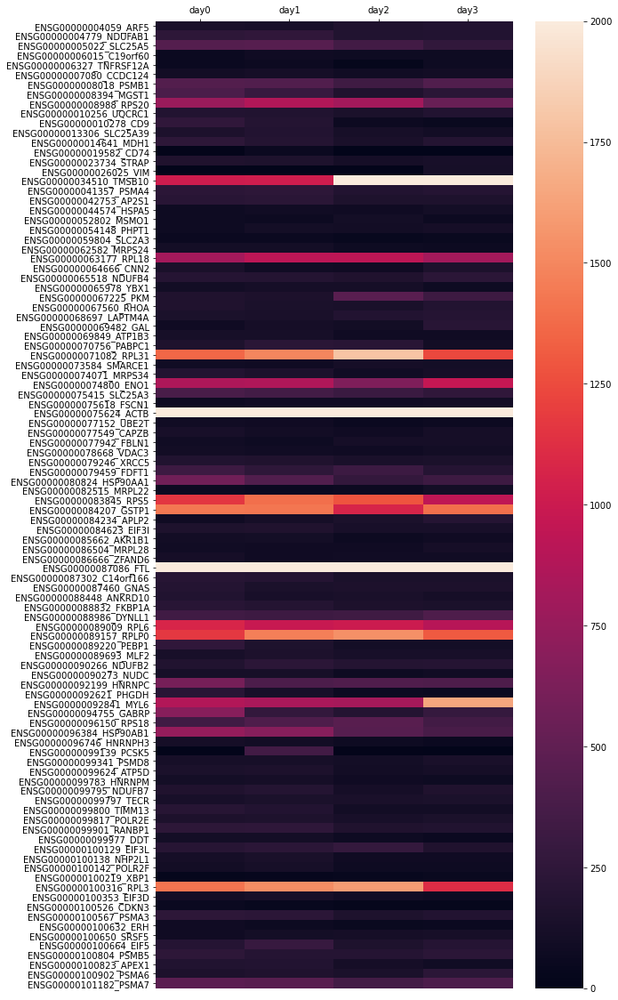

In [135]:
# heatmap of the different median values of the genes filtered by their variance (donor guss)
fig, ax = plt.subplots(figsize=(9, 20))
sns.heatmap(data = guss_mrg_byvard013[:100], vmin=0, vmax=2000)
ax.xaxis.tick_top()

#### Merging the most variable genes between day0 and day1 (Mann Whitney-test) with the median 

In [82]:
# calculating the number of genes filtered by a p-value of 0.0001
mwh_p_filt_d0d1 = mwhitney_pvalor_d0d1.loc[mwhitney_pvalor_d0d1["p-valor"] < 0.0001]
print(str(len(mwhitney_pvalor_d0d1) - len(mwh_p_filt_d0d1)) + " genes were filtered")

8003 genes were filtered


In [83]:
# we want the top 100 p-values
mwhitf_sort_d0d1 = mwh_p_filt_d0d1.sort_values(by= "p-valor", axis=0, ascending= True, inplace=False, kind= 'quicksort', na_position= 'last')
mwhitf_sort_d0d1 = mwhitf_sort_d0d1[:100]
mwhitf_sort_d0d1

,p-valor
gene,
ENSG00000164458_T,1.294723e-105
ENSG00000163508_EOMES,3.197108e-105
ENSG00000204335_SP5,4.430194e-104
ENSG00000185155_MIXL1,6.821461e-101
ENSG00000128683_GAD1,2.962354e-100
ENSG00000154096_THY1,5.547860e-78
ENSG00000108379_WNT3,4.807664e-76
ENSG00000179046_TRIML2,3.039866e-74
ENSG00000156574_NODAL,6.309511e-74


In [133]:
# Merging top 1000 most variated genes between day 0 and day 1 with median of expression of day 0 and day 1 (donor GUSS)
whitf_medd0d1 = guss_median0.merge(mwhitf_sort_d0d1, left_index=True, right_index=True)
whitf_medd0d1 =  whitf_medd0d1.drop("p-valor", axis=1)
whitf_medd0d1 = whitf_medd0d1.merge(guss_median1, left_index=True, right_index=True)
whitf_medd0d1.head()

,day0,day1
ENSG00000003436_TFPI,130.421420,27.265684
ENSG00000008083_JARID2,12.969227,3.743924
ENSG00000008311_AASS,37.519029,13.063064
ENSG00000048540_LMO3,7.187853,0.000000
ENSG00000048545_GUCA1A,2.076672,0.000000


<AxesSubplot:>

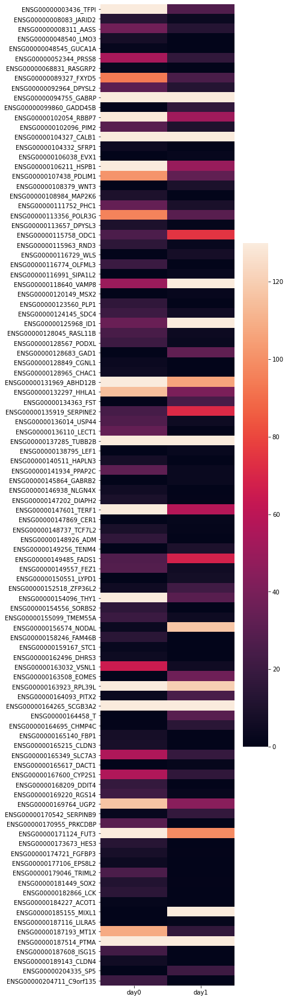

In [132]:
# heatmap of the different median of expression of the most variable genes between day0 and day 1
plt.figure(figsize=(5,30))
sns.heatmap(data = whitf_medd0d1[:100], vmin=0, vmax=130)

Podria hacer, en lugar de por día, por transición de día. Día 0-1 / dia 1-2 y tengo una tabla que me muestre si es significativa o no esa transición

# Merging tables: Gene expression by Day

In [ ]:
df_cellmeta.day.value_counts(ascending=False)

In [ ]:
#Merging tables: DAY 0
day_0_a = df_cellmeta.loc[df_cellmeta.day == 'day0',:].index
day0_mrg = df_raw.loc[df_raw.index.isin(day_0_a), :]
day0_mrg.head()

In [ ]:
len(day0_mrg) #The same lenght as day 0, so the merge works

In [ ]:
#Merging tables: DAY 1
day_1_a = df_cellmeta.loc[df_cellmeta.day == 'day1',:].index
day1_mrg = df_raw.loc[df_raw.index.isin(day_1_a), :]
day1_mrg.head()

In [ ]:
len(day1_mrg) #The same lenght as day 1, so the merge works

In [ ]:
#Merging tables: DAY 2
day_2_a = df_cellmeta.loc[df_cellmeta.day == 'day2',:].index
day2_mrg = df_raw.loc[df_raw.index.isin(day_2_a), :]
day2_mrg.head()

In [ ]:
len(day2_mrg) #The same lenght as day 2, so the merge works

In [ ]:
#Merging tables: DAY 3
day_3_a = df_cellmeta.loc[df_cellmeta.day == 'day3',:].index
day3_mrg = df_raw.loc[df_raw.index.isin(day_3_a), :]
day3_mrg.head()

In [ ]:
len(day3_mrg) #The same lenght as day 3, so the merge works

## Variance per day

### Day 0

In [ ]:
list_var0 = []
for column in range(0, len(day0_mrg.columns)):
    d0_columns = day0_mrg.iloc[:,column]
    d0_var = np.var(d0_columns.values)
    list_var0.append(d0_var)
d2_colnames = list(day0_mrg.columns.values)

In [ ]:
zip_varcolnames_d0 = list(zip(d2_colnames, list_var0))

In [ ]:
var_d0 = pd.DataFrame(zip_varcolnames_d0, columns = ["gene", "var"])
var_d0 = var_d0.set_index("gene")

In [ ]:
var_sort_d0 = var_d0.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
var_sort_d0 = var_sort_d0[:1000]
var_sort_d0

### Day 1

In [ ]:
list_var1 = []
for column in range(0, len(day1_mrg.columns)):
    d1_columns = day1_mrg.iloc[:,column]
    d1_var = np.var(d1_columns.values)
    list_var1.append(d1_var)
d1_colnames = list(day1_mrg.columns.values)

In [ ]:
zip_varcolnames_d1 = list(zip(d1_colnames, list_var1))

In [ ]:
var_d1 = pd.DataFrame(zip_varcolnames_d1, columns = ["gene", "var"])
var_d1 = var_d1.set_index("gene")

In [ ]:
var_sort_d1 = var_d1.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
var_sort_d1 = var_sort_d1[:1000]
var_sort_d1

### Day 2

In [ ]:
list_var2 = []
for column in range(0, len(day2_mrg.columns)):
    d2_columns = day2_mrg.iloc[:,column]
    d2_var = np.var(d2_columns.values)
    list_var2.append(d2_var)
d2_colnames = list(day2_mrg.columns.values)

In [ ]:
zip_varcolnames_d2 = list(zip(d2_colnames, list_var2))

In [ ]:
var_d2 = pd.DataFrame(zip_varcolnames_d2, columns = ["gene", "var"])
var_d2 = var_d2.set_index("gene")

In [ ]:
var_sort_d2 = var_d2.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
var_sort_d2 = var_sort_d2[:1000]
var_sort_d2

### Day 3

In [ ]:
list_var3 = []
for column in range(0, len(day3_mrg.columns)):
    d3_columns = day3_mrg.iloc[:,column]
    d3_var = np.var(d3_columns.values)
    list_var3.append(d3_var)
d3_colnames = list(day3_mrg.columns.values)

In [ ]:
zip_varcolnames_d3 = list(zip(d3_colnames, list_var3))

In [ ]:
var_d3 = pd.DataFrame(zip_varcolnames_d3, columns = ["gene", "var"])
var_d3 = var_d3.set_index("gene")

In [ ]:
var_sort_d3 = var_d3.sort_values(by= "var", axis=0, ascending= False, inplace=False, kind= 'quicksort', na_position= 'last')
var_sort_d3 = var_sort_d3[:1000]
var_sort_d3

# Conclusion

We were able to make an analysis through the day 0-3 by using the data from cells provided by **donor guss**.

The key graphs are:
- A lineplot showing the different expression levels of a specific gene of interest through the days with their respective p-value calculated using the Mann-Whitney test.
- A heatmap showing the different median of expression levels of a group of genes previously filtered by their variance. So, we visualized the genes with most variated levels of gene expression. 

The key utilities are:
- The possibility to make an analysis using a temporal variable (days 0-3) evaluating the differences of expression between these days.  

#### PAPELERA RECICLAJE

In [ ]:
'''
TUKEY FALLIDO
from scipy.stats import f_oneway
fstat, pval = f_oneway(gussd0_mrg_reduced, gussd1_mrg_reduced)
pval = pval[pval < 0.05] 

#from statsmodels.stats.multicomp import pairwise_tukeyhsd
#
tukey_results = pairwise_tukeyhsd(gussd0_mrg_reduced["ENSG00000001036_FUCA2"], gussd1_mrg_reduced["ENSG00000001461_NIPAL3"], 0.05)
print(tukey_results)

# Show the rejected results from the Tukey Test
tukey_data = pd.DataFrame(data=tukey_results._results_table.data[1:], columns = tukey_results._results_table.data[0])
group1_comp =tukey_data.loc[tukey_data.reject == True].groupby('group1').reject.count()
group2_comp = tukey_data.loc[tukey_data.reject == True].groupby('group2').reject.count()
tukey_data = pd.concat([group1_comp, group2_comp], axis=1)

tukey_data = tukey_data.fillna(0)
tukey_data.columns = ['reject1', 'reject2']
tukey_data['total_sum'] = tukey_data.reject1 + tukey_data.reject2

tukey_data.sort_values('total_sum',ascending=False).head(20)
'''

In [134]:
'''
# Line plot showing the level of expression of all days (bad)
fig, ax = plt.subplots(figsize=(10,10))
sns.lineplot(data= b10_guss_d0, marker = 'o', ax = ax, color = 'red')
sns.lineplot(data= b10_guss_d1, marker = 's', ax = ax, color = 'blue')
sns.lineplot(data= b10_guss_d2, marker = '^', ax = ax, color = 'green')
sns.lineplot(data= b10_guss_d3, marker = 'D', ax = ax, color = 'purple')
ax.legend(['Day 0', 'Day 1', 'Day 2', 'Day 3'], facecolor='w')
plt.xticks(rotation=90)
plt.title("Most 10 Expressed Genes (guss) - DAY 0-3")
ax.lines[0].set_linestyle("-")
ax.lines[1].set_linestyle("--")
ax.lines[2].set_linestyle("-.")
ax.lines[3].set_linestyle(":")
plt.show()
##### PERO hay un problema. Esto no me sirve porque en realidad no tienen los mismos ticks. Cada día tiene diferentes genes expresados ####
'''

'\n# Line plot showing the level of expression of all days (bad)\nfig, ax = plt.subplots(figsize=(10,10))\nsns.lineplot(data= b10_guss_d0, marker = \'o\', ax = ax, color = \'red\')\nsns.lineplot(data= b10_guss_d1, marker = \'s\', ax = ax, color = \'blue\')\nsns.lineplot(data= b10_guss_d2, marker = \'^\', ax = ax, color = \'green\')\nsns.lineplot(data= b10_guss_d3, marker = \'D\', ax = ax, color = \'purple\')\nax.legend([\'Day 0\', \'Day 1\', \'Day 2\', \'Day 3\'], facecolor=\'w\')\nplt.xticks(rotation=90)\nplt.title("Most 10 Expressed Genes (guss) - DAY 0-3")\nax.lines[0].set_linestyle("-")\nax.lines[1].set_linestyle("--")\nax.lines[2].set_linestyle("-.")\nax.lines[3].set_linestyle(":")\nplt.show()\n##### PERO hay un problema. Esto no me sirve porque en realidad no tienen los mismos ticks. Cada día tiene diferentes genes expresados ####\n'

In [ ]:
<